In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import datetime as dt
import pandas_profiling as pp
from scipy import stats
from scipy.stats import norm
from sklearn import metrics
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from scipy.stats.mstats import winsorize
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.naive_bayes import GaussianNB, MultinomialNB
from sklearn.neighbors import KNeighborsClassifier
from xgboost import XGBClassifier
from imblearn.over_sampling import SMOTE, RandomOverSampler
from imblearn.under_sampling import RandomUnderSampler
from sklearn.ensemble import GradientBoostingClassifier
from pycaret.classification import *
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.metrics import accuracy_score, auc, roc_auc_score, precision_score, mean_squared_error
from sklearn.metrics import classification_report, confusion_matrix, roc_curve, recall_score, f1_score
import warnings
warnings.filterwarnings('ignore')

In [2]:
tele = pd.read_csv('telecommunications_churn.csv', sep=';')
tele

,account_length,voice_mail_plan,voice_mail_messages,day_mins,evening_mins,night_mins,international_mins,customer_service_calls,international_plan,day_calls,day_charge,evening_calls,evening_charge,night_calls,night_charge,international_calls,international_charge,total_charge,churn
0,128,1,25,265.1,197.4,244.7,10.0,1,0,110,45.07,99,16.78,91,11.01,3,2.70,75.56,0
1,107,1,26,161.6,195.5,254.4,13.7,1,0,123,27.47,103,16.62,103,11.45,3,3.70,59.24,0
2,137,0,0,243.4,121.2,162.6,12.2,0,0,114,41.38,110,10.30,104,7.32,5,3.29,62.29,0
3,84,0,0,299.4,61.9,196.9,6.6,2,1,71,50.90,88,5.26,89,8.86,7,1.78,66.80,0
4,75,0,0,166.7,148.3,186.9,10.1,3,1,113,28.34,122,12.61,121,8.41,3,2.73,52.09,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3328,192,1,36,156.2,215.5,279.1,9.9,2,0,77,26.55,126,18.32,83,12.56,6,2.67,60.10,0
3329,68,0,0,231.1,153.4,191.3,9.6,3,0,57,39.29,55,13.04,123,8.61,4,2.59,63.53,0
3330,28,0,0,180.8,288.8,191.9,14.1,2,0,109,30.74,58,24.55,91,8.64,6,3.81,67.74,0
3331,184,0,0,213.8,159.6,139.2,5.0,2,1,105,36.35,84,13.57,137,6.26,10,1.35,57.53,0


## EDA

In [3]:
tele.describe()

,account_length,voice_mail_plan,voice_mail_messages,day_mins,evening_mins,night_mins,international_mins,customer_service_calls,international_plan,day_calls,day_charge,evening_calls,evening_charge,night_calls,night_charge,international_calls,international_charge,total_charge,churn
count,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000
mean,101.064806,0.276628,8.099010,179.775098,200.980348,200.872037,10.237294,1.562856,0.096910,100.435644,30.562307,100.114311,17.083540,100.107711,9.039325,4.479448,2.764581,59.449754,0.144914
std,39.822106,0.447398,13.688365,54.467389,50.713844,50.573847,2.791840,1.315491,0.295879,20.069084,9.259435,19.922625,4.310668,19.568609,2.275873,2.461214,0.753773,10.502261,0.352067
min,1.000000,0.000000,0.000000,0.000000,0.000000,23.200000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,33.000000,1.040000,0.000000,0.000000,22.930000,0.000000
25%,74.000000,0.000000,0.000000,143.700000,166.600000,167.000000,8.500000,1.000000,0.000000,87.000000,24.430000,87.000000,14.160000,87.000000,7.520000,3.000000,2.300000,52.380000,0.000000
50%,101.000000,0.000000,0.000000,179.400000,201.400000,201.200000,10.300000,1.000000,0.000000,101.000000,30.500000,100.000000,17.120000,100.000000,9.050000,4.000000,2.780000,59.470000,0.000000
75%,127.000000,1.000000,20.000000,216.400000,235.300000,235.300000,12.100000,2.000000,0.000000,114.000000,36.790000,114.000000,20.000000,113.000000,10.590000,6.000000,3.270000,66.480000,0.000000
max,243.000000,1.000000,51.000000,350.800000,363.700000,395.000000,20.000000,9.000000,1.000000,165.000000,59.640000,170.000000,30.910000,175.000000,17.770000,20.000000,5.400000,96.150000,1.000000


In [4]:
tele.dtypes

account_length              int64
voice_mail_plan             int64
voice_mail_messages         int64
day_mins                  float64
evening_mins              float64
night_mins                float64
international_mins        float64
customer_service_calls      int64
international_plan          int64
day_calls                   int64
day_charge                float64
evening_calls               int64
evening_charge            float64
night_calls                 int64
night_charge              float64
international_calls         int64
international_charge      float64
total_charge              float64
churn                       int64
dtype: object

In [5]:
tele.isnull().sum()

account_length            0
voice_mail_plan           0
voice_mail_messages       0
day_mins                  0
evening_mins              0
night_mins                0
international_mins        0
customer_service_calls    0
international_plan        0
day_calls                 0
day_charge                0
evening_calls             0
evening_charge            0
night_calls               0
night_charge              0
international_calls       0
international_charge      0
total_charge              0
churn                     0
dtype: int64

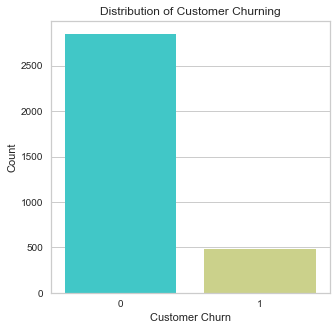

In [6]:
plt.figure(figsize=(5,5))
sns.countplot(x = tele.churn, palette='rainbow')
plt.xlabel('Customer Churn')
plt.ylabel('Count')
plt.title('Distribution of Customer Churning')
plt.show()

not_churned :  2850 , churned :  483


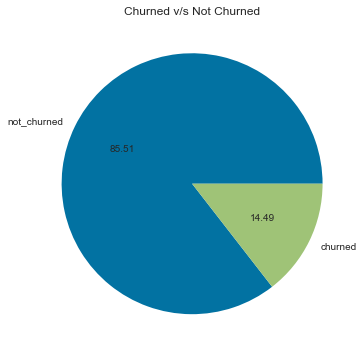

In [7]:
not_churned = tele[tele['churn']==0]['churn'].count()
churned = tele[tele['churn']==1]['churn'].count()
print('not_churned : ', not_churned, ', churned : ', churned)
fig = plt.figure(figsize=(6,6))
plt.pie([not_churned, churned], labels=['not_churned', 'churned'], autopct='%.2f')
plt.title('Churned v/s Not Churned')
plt.show()

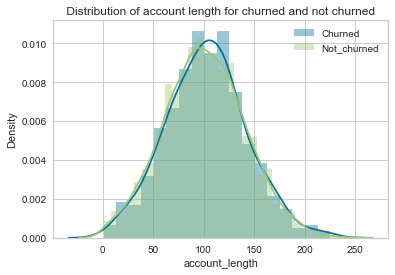

In [8]:
aclen_churned = tele[tele['churn']==1]['account_length']
aclen_notchurned = tele[tele['churn']==0]['account_length']
sns.distplot(aclen_churned, label='Churned')
sns.distplot(aclen_notchurned, label='Not_churned')
plt.title(' Distribution of account length for churned and not churned ')
plt.legend()
plt.show()

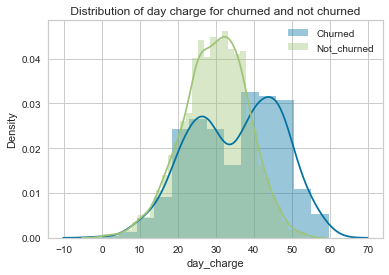

In [9]:
daycharge_churned = tele[tele['churn']==1]['day_charge']
daycharge_notchurned = tele[tele['churn']==0]['day_charge']
sns.distplot(daycharge_churned, label='Churned')
sns.distplot(daycharge_notchurned, label='Not_churned')
plt.title(' Distribution of day charge for churned and not churned ')
plt.legend()
plt.show()

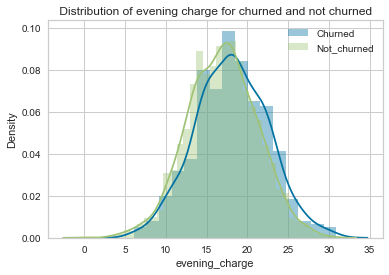

In [10]:
evecharge_churned = tele[tele['churn']==1]['evening_charge']
evecharge_notchurned = tele[tele['churn']==0]['evening_charge']
sns.distplot(evecharge_churned, label='Churned')
sns.distplot(evecharge_notchurned, label='Not_churned')
plt.title(' Distribution of evening charge for churned and not churned ')
plt.legend()
plt.show()

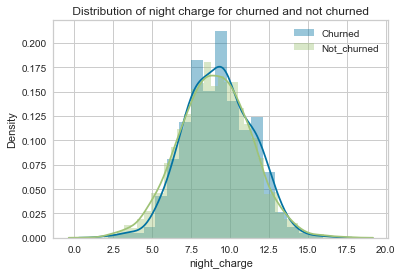

In [11]:
nightcharge_churned = tele[tele['churn']==1]['night_charge']
nightcharge_notchurned = tele[tele['churn']==0]['night_charge']
sns.distplot(nightcharge_churned, label='Churned')
sns.distplot(nightcharge_notchurned, label='Not_churned')
plt.title(' Distribution of night charge for churned and not churned ')
plt.legend()
plt.show()

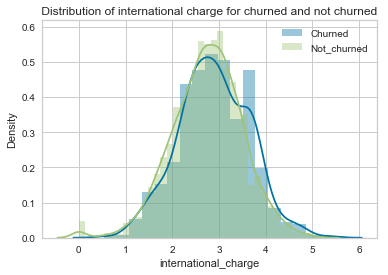

In [12]:
intlcharge_churned = tele[tele['churn']==1]['international_charge']
intlcharge_notchurned = tele[tele['churn']==0]['international_charge']
sns.distplot(intlcharge_churned, label='Churned')
sns.distplot(intlcharge_notchurned, label='Not_churned')
plt.title(' Distribution of international charge for churned and not churned ')
plt.legend()
plt.show()

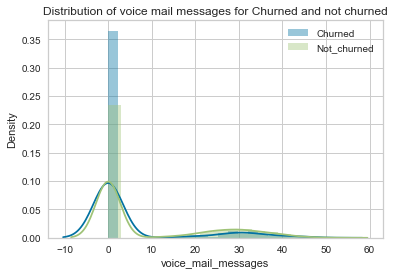

In [13]:
vmailmsgs_churned = tele[tele['churn']==1]['voice_mail_messages']
vmailmsgs_notchurned = tele[tele['churn']==0]['voice_mail_messages']
sns.distplot(vmailmsgs_churned, label='Churned')
sns.distplot(vmailmsgs_notchurned, label='Not_churned')
plt.title('Distribution of voice mail messages for Churned and not churned')
plt.legend()
plt.show()

In [14]:
print(tele.international_plan.value_counts())
print('\n', tele.voice_mail_plan.value_counts())
print('\n', tele.churn.value_counts())

0    3010
1     323
Name: international_plan, dtype: int64

 0    2411
1     922
Name: voice_mail_plan, dtype: int64

 0    2850
1     483
Name: churn, dtype: int64


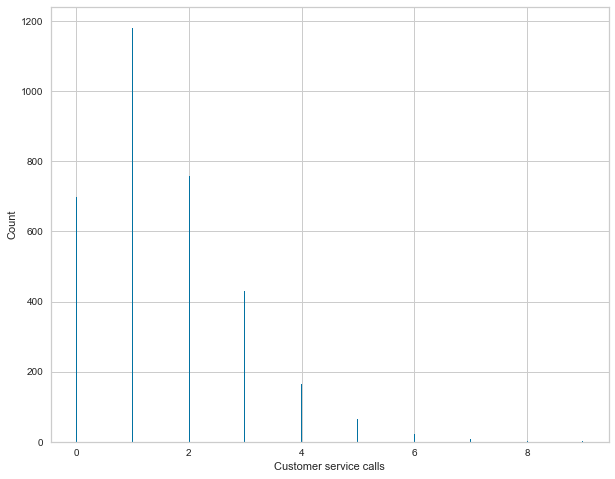

In [15]:
tele['customer_service_calls'].hist(bins=500, figsize=(10,8))
plt.xlabel('Customer service calls')
plt.ylabel('Count')
plt.show()

In [16]:
Churn = tele.groupby('churn').size()
Churn

churn
0    2850
1     483
dtype: int64

In [17]:
print('Churned percentage : ', (Churn[1]/3333)*100)
print('Not-Churned percentage : ', (Churn[0]/3333)*100)

Churned percentage :  14.491449144914492
Not-Churned percentage :  85.5085508550855


In [18]:
cols = ['account_length', 'voice_mail_plan', 'voice_mail_messages', 'day_mins', 'evening_mins', 'night_mins', 
        'international_mins', 'customer_service_calls', 'international_plan', 'day_calls', 'day_charge', 'evening_calls',
        'evening_charge', 'night_calls', 'night_charge', 'international_calls', 'international_charge', 'total_charge']

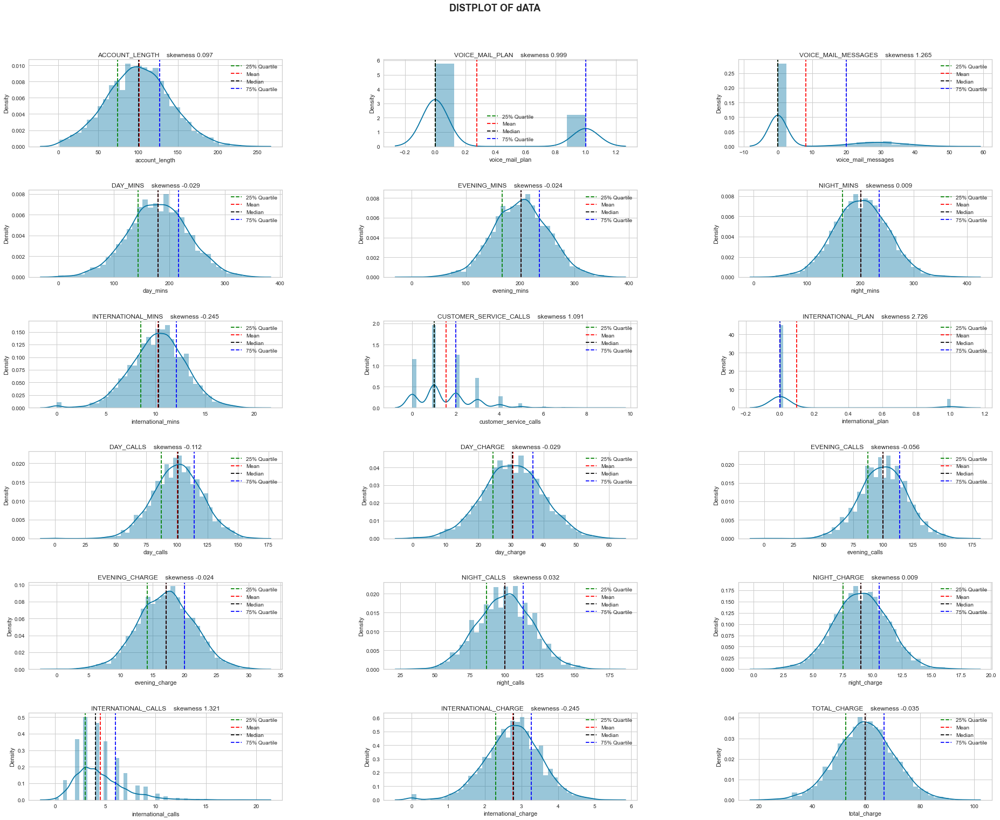

In [19]:
fig = plt.figure(figsize=[32,24])
fig.suptitle('DISTPLOT OF dATA', fontsize=18, fontweight='bold')
fig.subplots_adjust(top=0.92);
fig.subplots_adjust(hspace=0.5, wspace=0.4);
for i ,col in enumerate(cols):
    ax = fig.add_subplot(6, 3, i+1)
    ax = sns.distplot(tele[col]) 
    ax.axvline(tele[col].quantile(q=0.25),color='green',linestyle='--',label='25% Quartile')
    ax.axvline(tele[col].mean(),color='red',linestyle='--',label='Mean')
    ax.axvline(tele[col].median(),color='black',linestyle='--',label='Median')
    ax.axvline(tele[col].quantile(q=0.75),color='blue',linestyle='--',label='75% Quartile')
    ax.set_xlabel(f'{col}')
    ax.set_title(f'{col.upper()}    skewness {round(tele[col].skew(),3)}')
    ax.legend(fontsize=10) 

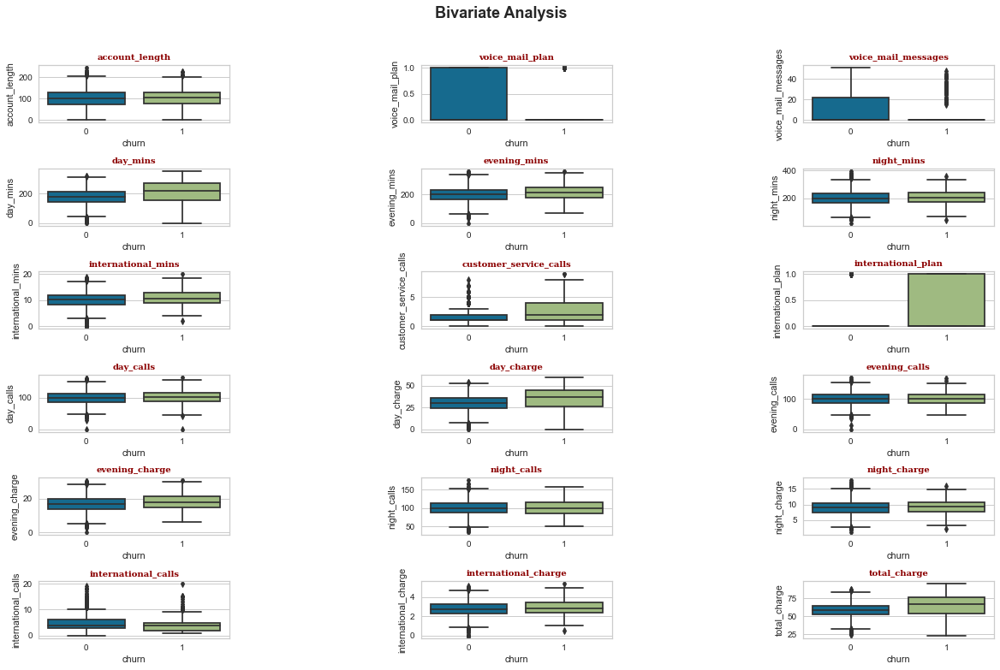

In [20]:
fig = plt.figure(figsize=[20,12])
fig.suptitle('Bivariate Analysis', fontsize=18, fontweight='bold')
fig.subplots_adjust(top=0.9);
fig.subplots_adjust(hspace=0.8, wspace=1);
for i, col in enumerate(cols):
    a = fig.add_subplot(6, 3, i+1)
    a = sns.boxplot(x='churn', y=col, ax=a, data=tele )
    a.set_title(col , fontdict = {'family':'serif', 'color':'darkred', 'weight':'bold', 'size':10})

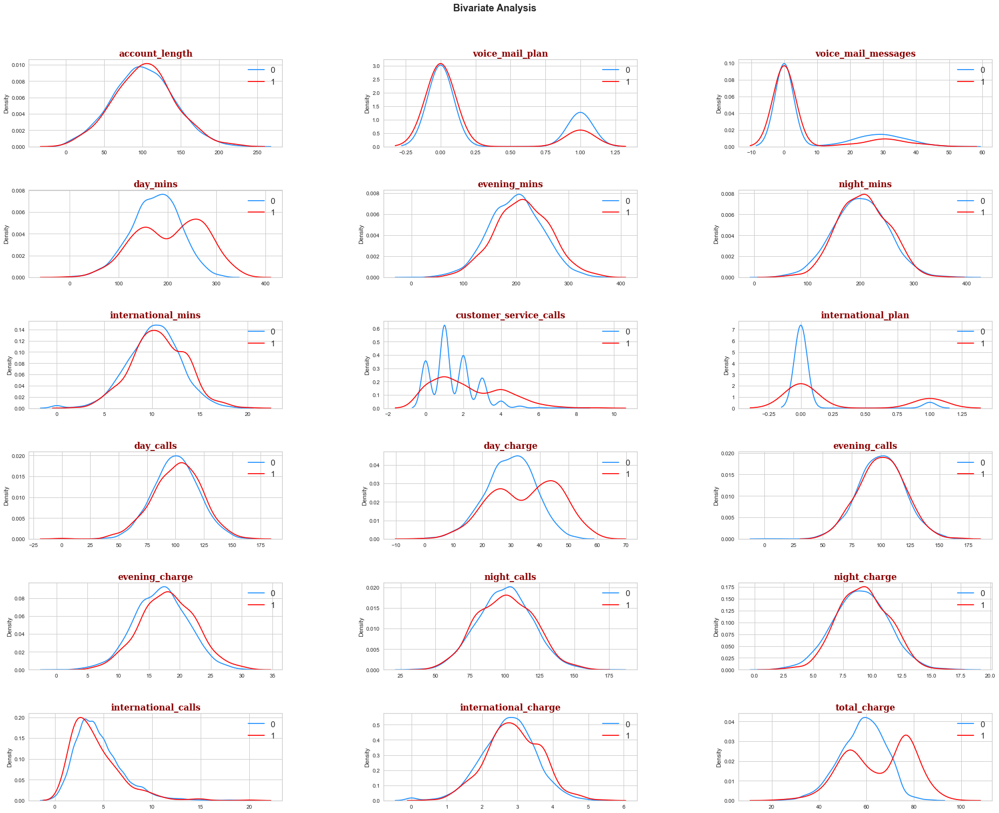

In [21]:
fig = plt.figure(figsize=[32,24])
fig.suptitle('Bivariate Analysis', fontsize=18, fontweight='bold')
fig.subplots_adjust(top=0.92);
fig.subplots_adjust(hspace=0.5, wspace=0.4);
for i ,col in enumerate(cols):
    a = fig.add_subplot(6, 3, i+1)
    sns.distplot(x =tele[tele['churn']==0][col],  color='dodgerblue' , ax=a ,  hist =False)
    sns.distplot(x =tele[tele['churn']==1][col],  color='red' , ax=a , hist =False) 
    a.set_title(col , fontdict={'family': 'serif','color':  'darkred','weight': 'bold','size': 16})    
    labels = [0 , 1]
    a.legend( labels  , fontsize = 15)

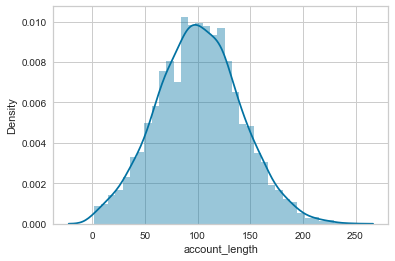

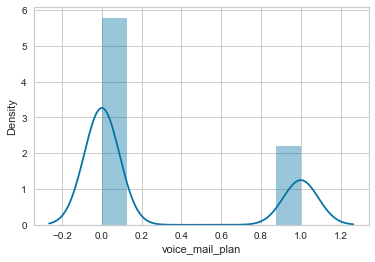

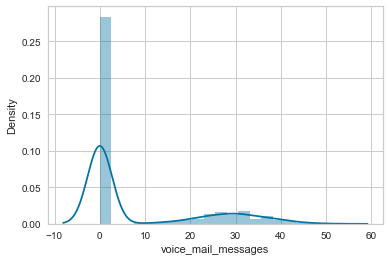

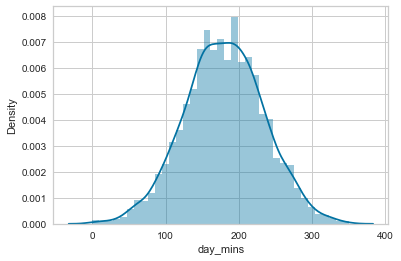

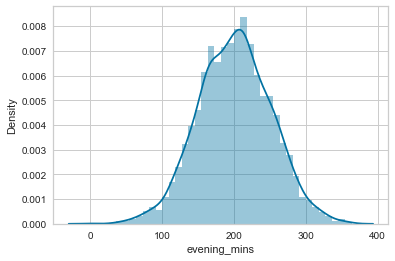

...

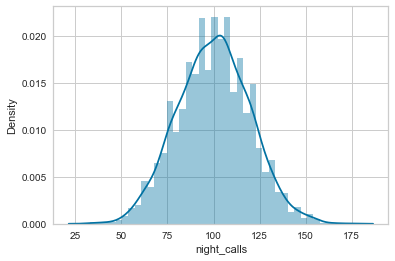

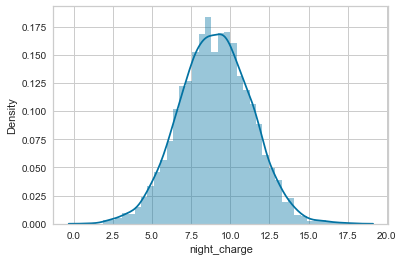

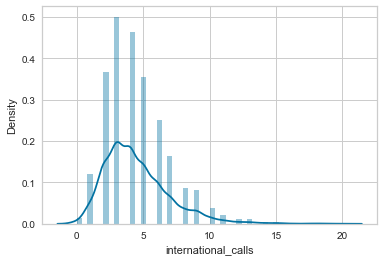

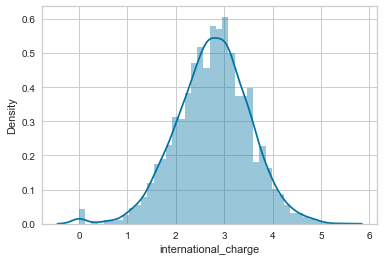

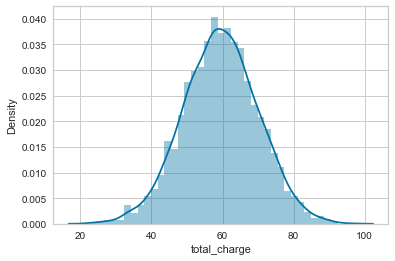

In [22]:
for feature in cols:
    sns.distplot(tele[feature])
    plt.xlabel(feature)
    plt.ylabel('Density')
    plt.show()

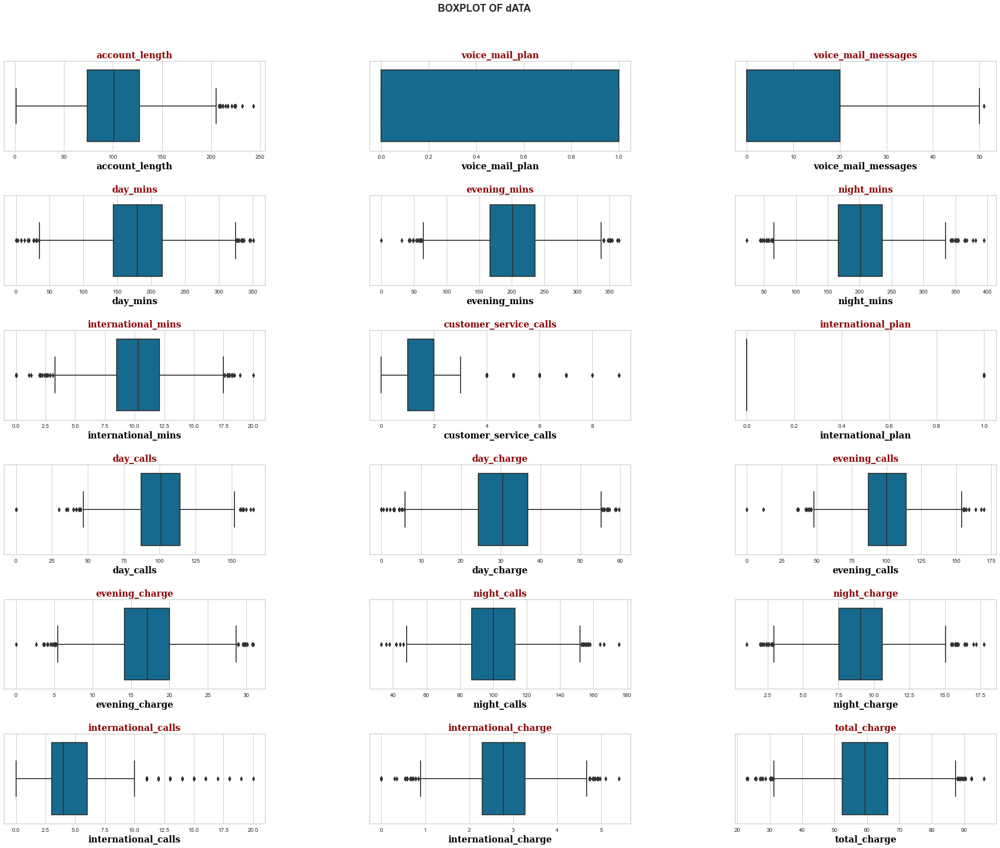

In [23]:
fig = plt.figure(figsize=[32,24])
fig.suptitle('BOXPLOT OF dATA', fontsize=18, fontweight='bold')
fig.subplots_adjust(top=0.92);
fig.subplots_adjust(hspace=0.5, wspace=0.4);
for i ,col in enumerate(cols):  
    ax1 = fig.add_subplot(6,3, i+1);
    ax1 = sns.boxplot(data = tele, x=col);
 
    ax1.set_title(f'{col}', fontdict={'family':'serif', 'color': 'darkred', 'weight':'bold', 'size':16}) 
    ax1.set_xlabel(f'{col}', fontdict={'family':'serif', 'color':'black', 'weight':'bold', 'size':16})

In [24]:
report_eda = pp.ProfileReport(tele)
report_eda.to_file(output_file='EDAreport')
report_eda

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

### Feature Engineering

In [25]:
tele1 = tele.drop('churn', axis=1)

In [26]:
cormat = tele1.corr()
cormat

,account_length,voice_mail_plan,voice_mail_messages,day_mins,evening_mins,night_mins,international_mins,customer_service_calls,international_plan,day_calls,day_charge,evening_calls,evening_charge,night_calls,night_charge,international_calls,international_charge,total_charge
account_length,1.000000,0.002918,-0.004628,0.006216,-0.006757,-0.008955,0.009514,-0.003796,0.024735,0.038470,0.006214,0.019260,-0.006745,-0.013176,-0.008960,0.020661,0.009546,0.001454
voice_mail_plan,0.002918,1.000000,0.956927,-0.001684,0.021545,0.006079,-0.001318,-0.017824,0.006006,-0.011086,-0.001686,-0.006444,0.021559,0.015553,0.006064,0.007618,-0.001276,0.008585
voice_mail_messages,-0.004628,0.956927,1.000000,0.000778,0.017562,0.007681,0.002856,-0.013263,0.008745,-0.009548,0.000776,-0.005864,0.017578,0.007123,0.007663,0.013957,0.002884,0.009766
day_mins,0.006216,-0.001684,0.000778,1.000000,0.007043,0.004323,-0.010155,-0.013423,0.049396,0.006750,1.000000,0.015769,0.007029,0.022972,0.004300,0.008033,-0.010092,0.884754
evening_mins,-0.006757,0.021545,0.017562,0.007043,1.000000,-0.012584,-0.011035,-0.012985,0.019100,-0.021451,0.007050,-0.011430,1.000000,0.007586,-0.012593,0.002541,-0.011067,0.413143
night_mins,-0.008955,0.006079,0.007681,0.004323,-0.012584,1.000000,-0.015207,-0.009288,-0.028905,0.022938,0.004324,-0.002093,-0.012592,0.011204,0.999999,-0.012353,-0.015180,0.214257
international_mins,0.009514,-0.001318,0.002856,-0.010155,-0.011035,-0.015207,1.000000,-0.009640,0.045871,0.021565,-0.010157,0.008703,-0.011043,-0.013605,-0.015214,0.032304,0.999993,0.054988
customer_service_calls,-0.003796,-0.017824,-0.013263,-0.013423,-0.012985,-0.009288,-0.009640,1.000000,-0.024522,-0.018942,-0.013427,0.002423,-0.012987,-0.012802,-0.009277,-0.017561,-0.009675,-0.019873
international_plan,0.024735,0.006006,0.008745,0.049396,0.019100,-0.028905,0.045871,-0.024522,1.000000,0.003755,0.049398,0.006114,0.019106,0.012451,-0.028913,0.017366,0.045780,0.048415
day_calls,0.038470,-0.011086,-0.009548,0.006750,-0.021451,0.022938,0.021565,-0.018942,0.003755,1.000000,0.006753,0.006462,-0.021449,-0.019557,0.022927,0.004574,0.021666,0.003673


<AxesSubplot:>

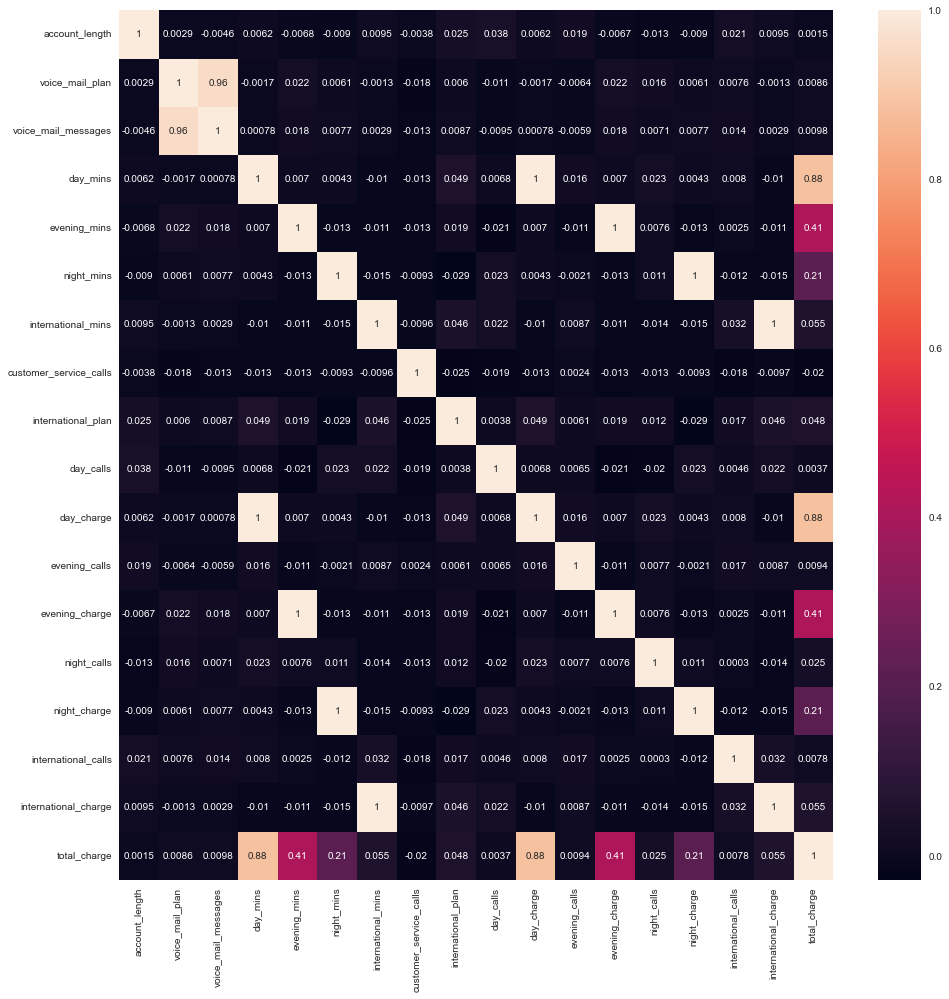

In [27]:
plt.figure(figsize=(16,16))
sns.heatmap(cormat, annot=True)

In [28]:
x = tele.drop(['churn'], axis=1)
y = tele.churn

In [29]:
x

,account_length,voice_mail_plan,voice_mail_messages,day_mins,evening_mins,night_mins,international_mins,customer_service_calls,international_plan,day_calls,day_charge,evening_calls,evening_charge,night_calls,night_charge,international_calls,international_charge,total_charge
0,128,1,25,265.1,197.4,244.7,10.0,1,0,110,45.07,99,16.78,91,11.01,3,2.70,75.56
1,107,1,26,161.6,195.5,254.4,13.7,1,0,123,27.47,103,16.62,103,11.45,3,3.70,59.24
2,137,0,0,243.4,121.2,162.6,12.2,0,0,114,41.38,110,10.30,104,7.32,5,3.29,62.29
3,84,0,0,299.4,61.9,196.9,6.6,2,1,71,50.90,88,5.26,89,8.86,7,1.78,66.80
4,75,0,0,166.7,148.3,186.9,10.1,3,1,113,28.34,122,12.61,121,8.41,3,2.73,52.09
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3328,192,1,36,156.2,215.5,279.1,9.9,2,0,77,26.55,126,18.32,83,12.56,6,2.67,60.10
3329,68,0,0,231.1,153.4,191.3,9.6,3,0,57,39.29,55,13.04,123,8.61,4,2.59,63.53
3330,28,0,0,180.8,288.8,191.9,14.1,2,0,109,30.74,58,24.55,91,8.64,6,3.81,67.74
3331,184,0,0,213.8,159.6,139.2,5.0,2,1,105,36.35,84,13.57,137,6.26,10,1.35,57.53


In [30]:
y

0       0
1       0
2       0
3       0
4       0
       ..
3328    0
3329    0
3330    0
3331    0
3332    0
Name: churn, Length: 3333, dtype: int64

In [31]:
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=42)

In [32]:
print('Before smote count of 0 {}'.format(sum(y_train==0)))
print('Before smote count of 1 {}'.format(sum(y_train==1)))
smt = SMOTE(sampling_strategy=1, random_state=5)
x_train_o, y_train_o = smt.fit_resample(x_train, y_train)
print('\n','After smote count of 0 {}'.format(sum(y_train_o==0)))
print('After smote count of 1 {}'.format(sum(y_train_o==1)))

Before smote count of 0 1993
Before smote count of 1 340

 After smote count of 0 1993
After smote count of 1 1993


In [33]:
oversample = RandomOverSampler(sampling_strategy='minority') #minority = 0.5
x_over, y_over = oversample.fit_resample(x_train, y_train)
print('\n','After over sample count of 0 {}'.format(sum(y_over==0)))
print('After over sample count of 1 {}'.format(sum(y_over==1)))


 After over sample count of 0 1993
After over sample count of 1 1993


## MODEL BUILDING 

### On SMOTE data:

In [34]:
gaussian_model_sm = GaussianNB()
gaussian_model_sm.fit(x_train_o, y_train_o)
gaussianpredtrain = gaussian_model_sm.predict(x_train_o)
gsm_a1 = round(accuracy_score(y_train_o, gaussianpredtrain), 4)

print('Accuracy Score                 :',gsm_a1)
print('Precision Score                :',round(precision_score(y_train_o, gaussianpredtrain), 4))
print('Recall Score                   :',round(recall_score(y_train_o, gaussianpredtrain), 4))
print('\nConfusion Matrix               :\n',confusion_matrix(y_train_o, gaussianpredtrain))
print('\nClassification Report          :\n',classification_report(y_train_o, gaussianpredtrain)) 
gaussianpredtest = gaussian_model_sm.predict(x_test)
gsm_a2 = round(accuracy_score(y_test, gaussianpredtest), 4)
print('Accuracy Score                 :',gsm_a2)
print('Precision Score                :',round(precision_score(y_test, gaussianpredtest), 4))
print('Recall Score                   :',round(recall_score(y_test, gaussianpredtest), 4))
print('\nConfusion Matrix               :\n',confusion_matrix(y_test, gaussianpredtest))
print('\nClassification Report          :\n',classification_report(y_test, gaussianpredtest))
rmse_gm_sm = np.sqrt(mean_squared_error(y_test, gaussianpredtest))
f1_gm_sm = f1_score(y_test, gaussianpredtest)
roc_gm_sm = roc_auc_score(y_test, gaussianpredtest)

Accuracy Score                 : 0.7346
Precision Score                : 0.7217
Recall Score                   : 0.7637

Confusion Matrix               :
 [[1406  587]
 [ 471 1522]]

Classification Report          :
               precision    recall  f1-score   support

           0       0.75      0.71      0.73      1993
           1       0.72      0.76      0.74      1993

    accuracy                           0.73      3986
   macro avg       0.74      0.73      0.73      3986
weighted avg       0.74      0.73      0.73      3986

Accuracy Score                 : 0.736
Precision Score                : 0.3246
Recall Score                   : 0.7832

Confusion Matrix               :
 [[624 233]
 [ 31 112]]

Classification Report          :
               precision    recall  f1-score   support

           0       0.95      0.73      0.83       857
           1       0.32      0.78      0.46       143

    accuracy                           0.74      1000
   macro avg       0.64   

Area Under Curve :  0.7556690683878549


Text(0, 0.5, 'True Positive Rate')

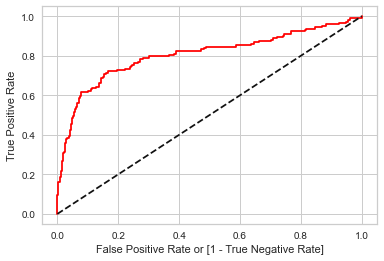

In [35]:
fpr, tpr, thresholds = roc_curve(y_test, gaussian_model_sm.predict_proba(x_test)[:,1])
auc_score = roc_auc_score(y_test, gaussianpredtest)
print('Area Under Curve : ', auc_score)
plt.plot(fpr, tpr, color='red', label='Gaussian model( area  = %0.2f)'%auc_score)
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate or [1 - True Negative Rate]')
plt.ylabel('True Positive Rate')

In [36]:
logistic_model_sm = LogisticRegression()
logistic_model_sm.fit(x_train_o, y_train_o)
logistic_pred_train = logistic_model_sm.predict(x_train_o)
lsm_a1 = round(accuracy_score(y_train_o, logistic_pred_train), 4)
print('Accuracy Score                 :',lsm_a1)
print('Precision Score                :',round(precision_score(y_train_o,logistic_pred_train), 4))
print('Recall Score                   :',round(recall_score(y_train_o, logistic_pred_train), 4))
print('\nConfusion Matrix               :\n',confusion_matrix(y_train_o, logistic_pred_train))
print('\nClassification Report          :\n',classification_report(y_train_o, logistic_pred_train)) 
logistic_pred_test = logistic_model_sm.predict(x_test)
lsm_a2 = round(accuracy_score(y_test, logistic_pred_test), 4)
print('Accuracy Score                 :',lsm_a2)
print('Precision Score                :',round(precision_score(y_test, logistic_pred_test), 4))
print('Recall Score                   :',round(recall_score(y_test, logistic_pred_test), 4))
print('\nConfusion Matrix               :\n',confusion_matrix(y_test, logistic_pred_test))
print('\nClassification Report          :\n',classification_report(y_test, logistic_pred_test))
rmse_lr_sm = np.sqrt(mean_squared_error(y_test, logistic_pred_test))
f1_lr_sm = f1_score(y_test, logistic_pred_test)
roc_lr_sm = roc_auc_score(y_test, logistic_pred_test)

Accuracy Score                 : 0.6708
Precision Score                : 0.6652
Recall Score                   : 0.6879

Confusion Matrix               :
 [[1303  690]
 [ 622 1371]]

Classification Report          :
               precision    recall  f1-score   support

           0       0.68      0.65      0.67      1993
           1       0.67      0.69      0.68      1993

    accuracy                           0.67      3986
   macro avg       0.67      0.67      0.67      3986
weighted avg       0.67      0.67      0.67      3986

Accuracy Score                 : 0.677
Precision Score                : 0.2668
Recall Score                   : 0.7203

Confusion Matrix               :
 [[574 283]
 [ 40 103]]

Classification Report          :
               precision    recall  f1-score   support

           0       0.93      0.67      0.78       857
           1       0.27      0.72      0.39       143

    accuracy                           0.68      1000
   macro avg       0.60   

Area Under Curve :  0.6950290083312254


Text(0, 0.5, 'True Positive Rate')

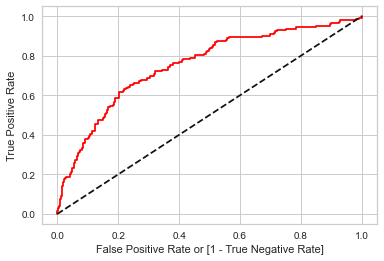

In [37]:
fpr, tpr, thresholds = roc_curve(y_test,logistic_model_sm.predict_proba(x_test)[:,1])
auc_score = roc_auc_score(y_test, logistic_pred_test)
print('Area Under Curve : ', auc_score)
plt.plot(fpr, tpr, color='red', label='logist model( area  = %0.2f)'%auc_score)
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate or [1 - True Negative Rate]')
plt.ylabel('True Positive Rate')

In [38]:
xg_model_sm = GradientBoostingClassifier(learning_rate=0.001, n_estimators=100, max_depth=3)
xg_model_sm.fit(x_train_o, y_train_o)
xgpredtestt = xg_model_sm.predict(x_test)
xg_a2 = round(accuracy_score(y_test, xgpredtestt), 4)
rmse_xg_sm = np.sqrt(mean_squared_error(y_test, xgpredtestt))
f1_xg_sm = f1_score(y_test, xgpredtestt)
roc_xg_sm = roc_auc_score(y_test, xgpredtestt)
print('Accuracy Score                 :',xg_a2)
print('Precision Score                :',round(precision_score(y_test, xgpredtestt), 4))
print('Recall Score                   :',round(recall_score(y_test, xgpredtestt), 4))
print('\nConfusion Matrix               :\n',confusion_matrix(y_test, xgpredtestt))
print('\nClassification Report          :\n',classification_report(y_test, xgpredtestt))
xgpredtrain = xg_model_sm.predict(x_train_o)
xg_a1 = round(accuracy_score(y_train_o, xgpredtrain), 4)
print('Accuracy Score                 :',xg_a1)
print('Precision Score                :',round(precision_score(y_train_o, xgpredtrain), 4))
print('Recall Score                   :',round(recall_score(y_train_o, xgpredtrain), 4))
print('\nConfusion Matrix               :\n',confusion_matrix(y_train_o, xgpredtrain))
print('\nClassification Report          :\n',classification_report(y_train_o, xgpredtrain)) 

Accuracy Score                 : 0.925
Precision Score                : 0.6828
Recall Score                   : 0.8881

Confusion Matrix               :
 [[798  59]
 [ 16 127]]

Classification Report          :
               precision    recall  f1-score   support

           0       0.98      0.93      0.96       857
           1       0.68      0.89      0.77       143

    accuracy                           0.93      1000
   macro avg       0.83      0.91      0.86      1000
weighted avg       0.94      0.93      0.93      1000

Accuracy Score                 : 0.8136
Precision Score                : 0.9206
Recall Score                   : 0.6864

Confusion Matrix               :
 [[1875  118]
 [ 625 1368]]

Classification Report          :
               precision    recall  f1-score   support

           0       0.75      0.94      0.83      1993
           1       0.92      0.69      0.79      1993

    accuracy                           0.81      3986
   macro avg       0.84   

In [39]:
rf_model_sm = RandomForestClassifier(max_depth=10, random_state=42, n_estimators=5)
rf_model_sm.fit(x_train_o, y_train_o)
rfpredtrain = rf_model_sm.predict(x_train_o)
rf_a1 = round(accuracy_score(y_train_o, rfpredtrain), 4)
print('Accuracy Score                 :',rf_a1)
print('Precision Score                :',round(precision_score(y_train_o, rfpredtrain), 4))
print('Recall Score                   :',round(recall_score(y_train_o, rfpredtrain), 4))
print('\nConfusion Matrix               :\n',confusion_matrix(y_train_o, rfpredtrain))
print('\nClassification Report          :\n',classification_report(y_train_o, rfpredtrain)) 
rfpredtestt = rf_model_sm.predict(x_test)
rf_a2 = round(accuracy_score(y_test, rfpredtestt), 4)
print('Accuracy Score                 :',rf_a2)
print('Precision Score                :',round(precision_score(y_test, rfpredtestt), 4))
print('Recall Score                   :',round(recall_score(y_test, rfpredtestt), 4))
print('\nConfusion Matrix               :\n',confusion_matrix(y_test, rfpredtestt))
print('\nClassification Report          :\n',classification_report(y_test, rfpredtestt))

rmse_rf_sm = np.sqrt(mean_squared_error(y_test, rfpredtestt))
f1_rf_sm = f1_score(y_test, rfpredtestt)
roc_rf_sm = roc_auc_score(y_test, rfpredtestt)

Accuracy Score                 : 0.9358
Precision Score                : 0.978
Recall Score                   : 0.8916

Confusion Matrix               :
 [[1953   40]
 [ 216 1777]]

Classification Report          :
               precision    recall  f1-score   support

           0       0.90      0.98      0.94      1993
           1       0.98      0.89      0.93      1993

    accuracy                           0.94      3986
   macro avg       0.94      0.94      0.94      3986
weighted avg       0.94      0.94      0.94      3986

Accuracy Score                 : 0.92
Precision Score                : 0.7006
Recall Score                   : 0.7692

Confusion Matrix               :
 [[810  47]
 [ 33 110]]

Classification Report          :
               precision    recall  f1-score   support

           0       0.96      0.95      0.95       857
           1       0.70      0.77      0.73       143

    accuracy                           0.92      1000
   macro avg       0.83     

Area Under Curve :  0.8571941477425724


Text(0, 0.5, 'True Positive Rate')

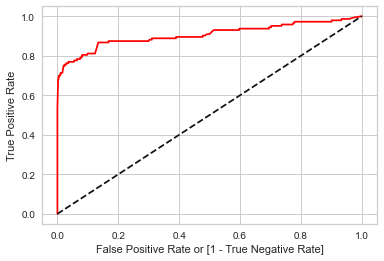

In [40]:
fpr, tpr, thresholds = roc_curve(y_test, rf_model_sm.predict_proba(x_test)[:,1])
auc_score = roc_auc_score(y_test, rfpredtestt)
print('Area Under Curve : ', auc_score)
plt.plot(fpr, tpr, color='red', label='Random model( area  = %0.2f)'%auc_score)
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate or [1 - True Negative Rate]')
plt.ylabel('True Positive Rate')

In [41]:
osvc_sm = SVC( decision_function_shape='ovr')
osvc_sm.fit(x_train_o, y_train_o)
svcpredtest = osvc_sm.predict(x_test)
osvc_a2 = round(accuracy_score(y_test, svcpredtest), 4)
rmse_svc_sm = np.sqrt(mean_squared_error(y_test, svcpredtest))
f1_svc_sm = f1_score(y_test, svcpredtest)
roc_svc_sm = roc_auc_score(y_test, svcpredtest)

print('Accuracy Score                 :',osvc_a2)
print('Precision Score                :',round(precision_score(y_test, svcpredtest), 4))
print('Recall Score                   :',round(recall_score(y_test, svcpredtest), 4))
print('\nConfusion Matrix               :\n',confusion_matrix(y_test, svcpredtest))
print('\nClassification Report          :\n',classification_report(y_test, svcpredtest))
svcpredtrain = osvc_sm.predict(x_train_o)
osvc_a1 = round(accuracy_score(y_train_o, svcpredtrain), 4)
print('Accuracy Score                 :',osvc_a1)
print('Precision Score                :',round(precision_score(y_train_o, svcpredtrain), 4))
print('Recall Score                   :',round(recall_score(y_train_o, svcpredtrain), 4))
print('\nConfusion Matrix               :\n',confusion_matrix(y_train_o, svcpredtrain))
print('\nClassification Report          :\n',classification_report(y_train_o, svcpredtrain)) 

Accuracy Score                 : 0.855
Precision Score                : 0.4934
Recall Score                   : 0.5245

Confusion Matrix               :
 [[780  77]
 [ 68  75]]

Classification Report          :
               precision    recall  f1-score   support

           0       0.92      0.91      0.91       857
           1       0.49      0.52      0.51       143

    accuracy                           0.85      1000
   macro avg       0.71      0.72      0.71      1000
weighted avg       0.86      0.85      0.86      1000

Accuracy Score                 : 0.6869
Precision Score                : 0.8317
Recall Score                   : 0.4686

Confusion Matrix               :
 [[1804  189]
 [1059  934]]

Classification Report          :
               precision    recall  f1-score   support

           0       0.63      0.91      0.74      1993
           1       0.83      0.47      0.60      1993

    accuracy                           0.69      3986
   macro avg       0.73   

### On OverSampled data

In [42]:
rf_model_final = RandomForestClassifier(max_depth=10, random_state=42, n_estimators=5)
rf_model_final.fit(x_over, y_over)
rfpredtrain = rf_model_final.predict(x_over)
rf_OS_a1 = round(accuracy_score(y_over, rfpredtrain), 4)
print('Accuracy Score                 :',rf_OS_a1)
print('Precision Score                :',round(precision_score(y_over, rfpredtrain), 4))
print('Recall Score                   :',round(recall_score(y_over, rfpredtrain), 4))
print('\nConfusion Matrix               :\n',confusion_matrix(y_over, rfpredtrain))
print('\nClassification Report          :\n',classification_report(y_over, rfpredtrain)) 
rfpredtest = rf_model_final.predict(x_test)
rf_OS_a2 = round(accuracy_score(y_test, rfpredtest), 4)
print('Accuracy Score                 :',rf_OS_a2)
print('Precision Score                :',round(precision_score(y_test, rfpredtest), 4))
print('Recall Score                   :',round(recall_score(y_test, rfpredtest), 4))
print('\nConfusion Matrix               :\n',confusion_matrix(y_test, rfpredtest))
print('\nClassification Report          :\n',classification_report(y_test, rfpredtest))
rmse_rf_OV = np.sqrt(mean_squared_error(y_test, rfpredtest))
f1_rf_OV = f1_score(y_test, rfpredtest)
roc_rf_OV = roc_auc_score(y_test, rfpredtest)

Accuracy Score                 : 0.9714
Precision Score                : 0.9984
Recall Score                   : 0.9443

Confusion Matrix               :
 [[1990    3]
 [ 111 1882]]

Classification Report          :
               precision    recall  f1-score   support

           0       0.95      1.00      0.97      1993
           1       1.00      0.94      0.97      1993

    accuracy                           0.97      3986
   macro avg       0.97      0.97      0.97      3986
weighted avg       0.97      0.97      0.97      3986

Accuracy Score                 : 0.974
Precision Score                : 0.9333
Recall Score                   : 0.8811

Confusion Matrix               :
 [[848   9]
 [ 17 126]]

Classification Report          :
               precision    recall  f1-score   support

           0       0.98      0.99      0.98       857
           1       0.93      0.88      0.91       143

    accuracy                           0.97      1000
   macro avg       0.96   

In [43]:
adamodel_ov = AdaBoostClassifier()
adamodel_ov.fit(x_over, y_over)
adapredtest = adamodel_ov.predict(x_test)
ada_OV_a2 = round(accuracy_score(y_test, adapredtest), 4)
rmse_ada_OV = np.sqrt(mean_squared_error(y_test, adapredtest))
f1_ada_OV = f1_score(y_test, adapredtest)
roc_ada_OV = roc_auc_score(y_test, adapredtest)

print('Accuracy Score                 :',ada_OV_a2)
print('Precision Score                :',round(precision_score(y_test, adapredtest), 4))
print('Recall Score                   :',round(recall_score(y_test, adapredtest), 4))
print('\nConfusion Matrix               :\n',confusion_matrix(y_test, adapredtest))
print('\nClassification Report          :\n',classification_report(y_test, adapredtest))
adapredtrain = adamodel_ov.predict(x_over)
ada_OV_a1 = round(accuracy_score(y_over, adapredtrain), 4)
print('Accuracy Score                 :',ada_OV_a1)
print('Precision Score                :',round(precision_score(y_over, adapredtrain), 4))
print('Recall Score                   :',round(recall_score(y_over, adapredtrain), 4))
print('\nConfusion Matrix               :\n',confusion_matrix(y_over, adapredtrain))
print('\nClassification Report          :\n',classification_report(y_over, adapredtrain)) 

Accuracy Score                 : 0.883
Precision Score                : 0.5596
Recall Score                   : 0.8531

Confusion Matrix               :
 [[761  96]
 [ 21 122]]

Classification Report          :
               precision    recall  f1-score   support

           0       0.97      0.89      0.93       857
           1       0.56      0.85      0.68       143

    accuracy                           0.88      1000
   macro avg       0.77      0.87      0.80      1000
weighted avg       0.91      0.88      0.89      1000

Accuracy Score                 : 0.8728
Precision Score                : 0.8944
Recall Score                   : 0.8455

Confusion Matrix               :
 [[1794  199]
 [ 308 1685]]

Classification Report          :
               precision    recall  f1-score   support

           0       0.85      0.90      0.88      1993
           1       0.89      0.85      0.87      1993

    accuracy                           0.87      3986
   macro avg       0.87   

In [44]:
dtcover = DecisionTreeClassifier()
dtcover.fit(x_over, y_over)
dtcpredtrain = dtcover.predict(x_over)
dtc_OV_a1 = round(accuracy_score(y_over, dtcpredtrain), 4)
print('Accuracy Score                 :',dtc_OV_a1)
print('Precision Score                :',round(precision_score(y_over, dtcpredtrain), 4))
print('Recall Score                   :',round(recall_score(y_over, dtcpredtrain), 4))
print('\nConfusion Matrix               :\n',confusion_matrix(y_over, dtcpredtrain))
print('\nClassification Report          :\n',classification_report(y_over, dtcpredtrain)) 
dtc_ypred = dtcover.predict(x_test)
dtc_OV_a2 = round(accuracy_score(y_test, dtc_ypred), 4)
rmse_dt_OV = np.sqrt(mean_squared_error(y_test, dtc_ypred))
f1_dt_OV = f1_score(y_test, dtc_ypred)
roc_dt_OV = roc_auc_score(y_test, dtc_ypred)


print('Accuracy Score                 :',dtc_OV_a2)
print('Precision Score                :',round(precision_score(y_test, dtc_ypred), 4))
print('Recall Score                   :',round(recall_score(y_test, dtc_ypred), 4))
print('\nConfusion Matrix               :\n',confusion_matrix(y_test, dtc_ypred))
print('\nClassification Report          :\n',classification_report(y_test, dtc_ypred))


Accuracy Score                 : 1.0
Precision Score                : 1.0
Recall Score                   : 1.0

Confusion Matrix               :
 [[1993    0]
 [   0 1993]]

Classification Report          :
               precision    recall  f1-score   support

           0       1.00      1.00      1.00      1993
           1       1.00      1.00      1.00      1993

    accuracy                           1.00      3986
   macro avg       1.00      1.00      1.00      3986
weighted avg       1.00      1.00      1.00      3986

Accuracy Score                 : 0.956
Precision Score                : 0.8235
Recall Score                   : 0.8811

Confusion Matrix               :
 [[830  27]
 [ 17 126]]

Classification Report          :
               precision    recall  f1-score   support

           0       0.98      0.97      0.97       857
           1       0.82      0.88      0.85       143

    accuracy                           0.96      1000
   macro avg       0.90      0.92  

### On Original Data

In [45]:
rf_modelor = RandomForestClassifier()
rf_modelor.fit(x_train, y_train)
rfpredtrain = rf_modelor.predict(x_train)
rf_OR_a1 = round(accuracy_score(y_train, rfpredtrain), 4)
print('Accuracy Score                 :',rf_OR_a1)
print('Precision Score                :',round(precision_score(y_train, rfpredtrain), 4))
print('Recall Score                   :',round(recall_score(y_train, rfpredtrain), 4))
print('\nConfusion Matrix               :\n',confusion_matrix(y_train, rfpredtrain))
print('\nClassification Report          :\n',classification_report(y_train, rfpredtrain)) 
rfpred_test = rf_modelor.predict(x_test)
rf_OR_a2 = round(accuracy_score(y_test, rfpred_test), 4)
rmse_rf_ori = np.sqrt(mean_squared_error(y_test, rfpred_test))
f1_rf_ori = f1_score(y_test, rfpred_test)
roc_rf_ori = roc_auc_score(y_test, rfpred_test)


print('Accuracy Score                 :',rf_OR_a2)
print('Precision Score                :',round(precision_score(y_test, rfpred_test), 4))
print('Recall Score                   :',round(recall_score(y_test, rfpred_test), 4))
print('\nConfusion Matrix               :\n',confusion_matrix(y_test, rfpred_test))
print('\nClassification Report          :\n',classification_report(y_test, rfpred_test))

Accuracy Score                 : 1.0
Precision Score                : 1.0
Recall Score                   : 1.0

Confusion Matrix               :
 [[1993    0]
 [   0  340]]

Classification Report          :
               precision    recall  f1-score   support

           0       1.00      1.00      1.00      1993
           1       1.00      1.00      1.00       340

    accuracy                           1.00      2333
   macro avg       1.00      1.00      1.00      2333
weighted avg       1.00      1.00      1.00      2333

Accuracy Score                 : 0.983
Precision Score                : 1.0
Recall Score                   : 0.8811

Confusion Matrix               :
 [[857   0]
 [ 17 126]]

Classification Report          :
               precision    recall  f1-score   support

           0       0.98      1.00      0.99       857
           1       1.00      0.88      0.94       143

    accuracy                           0.98      1000
   macro avg       0.99      0.94     

In [46]:
adamodel = AdaBoostClassifier()
adamodel.fit(x_train, y_train)
adapred_test = adamodel.predict(x_test)
ada_OR_a2 = round(accuracy_score(y_test, adapred_test), 4)
rmse_ada_ori = np.sqrt(mean_squared_error(y_test, adapred_test))
f1_ada_ori = f1_score(y_test, adapred_test)
roc_ada_ori = roc_auc_score(y_test, adapred_test)

print('Accuracy Score                 :',ada_OR_a2)
print('Precision Score                :',round(precision_score(y_test, adapred_test), 4))
print('Recall Score                   :',round(recall_score(y_test, adapred_test), 4))
print('\nConfusion Matrix               :\n',confusion_matrix(y_test, adapred_test))
print('\nClassification Report          :\n',classification_report(y_test, adapred_test))
adapredtrain = adamodel.predict(x_train)
ada_OR_a1 = round(accuracy_score(y_train, adapredtrain), 4)
print('Accuracy Score                 :',ada_OR_a1)
print('Precision Score                :',round(precision_score(y_train, adapredtrain), 4))
print('Recall Score                   :',round(recall_score(y_train, adapredtrain), 4))
print('\nConfusion Matrix               :\n',confusion_matrix(y_train, adapredtrain))
print('\nClassification Report          :\n',classification_report(y_train, adapredtrain)) 

Accuracy Score                 : 0.922
Precision Score                : 0.7982
Recall Score                   : 0.6084

Confusion Matrix               :
 [[835  22]
 [ 56  87]]

Classification Report          :
               precision    recall  f1-score   support

           0       0.94      0.97      0.96       857
           1       0.80      0.61      0.69       143

    accuracy                           0.92      1000
   macro avg       0.87      0.79      0.82      1000
weighted avg       0.92      0.92      0.92      1000

Accuracy Score                 : 0.9288
Precision Score                : 0.8199
Recall Score                   : 0.6559

Confusion Matrix               :
 [[1944   49]
 [ 117  223]]

Classification Report          :
               precision    recall  f1-score   support

           0       0.94      0.98      0.96      1993
           1       0.82      0.66      0.73       340

    accuracy                           0.93      2333
   macro avg       0.88   

In [47]:
xg_model = GradientBoostingClassifier(learning_rate=0.001, n_estimators=100, max_depth=3)
xg_model.fit(x_train, y_train)
xgpredtest = xg_model.predict(x_test)
xg_OR_a2 = round(accuracy_score(y_test, xgpredtest), 4)
rmse_xg_ori = np.sqrt(mean_squared_error(y_test, xgpredtest))
f1_xg_ori = f1_score(y_test, xgpredtest)
roc_xg_ori = roc_auc_score(y_test, xgpredtest)


print('Accuracy Score                 :',xg_OR_a2)
print('Precision Score                :',round(precision_score(y_test, xgpredtest), 4))
print('Recall Score                   :',round(recall_score(y_test, xgpredtest), 4))
print('\nConfusion Matrix               :\n',confusion_matrix(y_test, xgpredtest))
print('\nClassification Report          :\n',classification_report(y_test, xgpredtest))
xgpredtrain = xg_model.predict(x_train)
xg_OR_a1 = round(accuracy_score(y_train, xgpredtrain), 4)
print('Accuracy Score                 :',xg_OR_a1)
print('Precision Score                :',round(precision_score(y_train, xgpredtrain), 4))
print('Recall Score                   :',round(recall_score(y_train, xgpredtrain), 4))
print('\nConfusion Matrix               :\n',confusion_matrix(y_train, xgpredtrain))
print('\nClassification Report          :\n',classification_report(y_train, xgpredtrain)) 

Accuracy Score                 : 0.857
Precision Score                : 0.0
Recall Score                   : 0.0

Confusion Matrix               :
 [[857   0]
 [143   0]]

Classification Report          :
               precision    recall  f1-score   support

           0       0.86      1.00      0.92       857
           1       0.00      0.00      0.00       143

    accuracy                           0.86      1000
   macro avg       0.43      0.50      0.46      1000
weighted avg       0.73      0.86      0.79      1000

Accuracy Score                 : 0.8543
Precision Score                : 0.0
Recall Score                   : 0.0

Confusion Matrix               :
 [[1993    0]
 [ 340    0]]

Classification Report          :
               precision    recall  f1-score   support

           0       0.85      1.00      0.92      1993
           1       0.00      0.00      0.00       340

    accuracy                           0.85      2333
   macro avg       0.43      0.50     

In [48]:
Accu=pd.DataFrame({"Model":["Gaussian Model(SMOTE)","Logistic Model(SMOTE)","Gradient Boost Model(SMOTE)","Random Forest Model(SMOTE)","SVM Model(SMOTE)","Random Forest Model(Over Sample)","AdaBoost Model(Over Sample)","Decision Tree Model(Over Sample)", "Random Forest Model(Ori)", "AdaBoost Model(Ori)", "Gradient Boost Model(Ori)"],
                     "Training Acc":[gsm_a1, lsm_a1, xg_a1, rf_a1, osvc_a1, rf_OS_a1, ada_OV_a1, dtc_OV_a1, rf_OR_a1, ada_OR_a1, xg_OR_a1],
                     "Testing Acc":[gsm_a2, lsm_a2, xg_a2, rf_a2, osvc_a2, rf_OS_a2, ada_OV_a2, dtc_OV_a2, rf_OR_a2, ada_OR_a2, xg_OR_a2],
                   "RMSE" : [rmse_gm_sm, rmse_lr_sm, rmse_xg_sm, rmse_rf_sm, rmse_svc_sm, rmse_rf_OV, rmse_ada_OV, rmse_dt_OV, rmse_rf_ori, rmse_ada_ori, rmse_xg_ori],
                   "F1 Score" : [f1_gm_sm, f1_lr_sm, f1_xg_sm, f1_rf_sm, f1_svc_sm, f1_rf_OV, f1_ada_OV, f1_dt_OV, f1_rf_ori, f1_ada_ori, f1_xg_ori],
                   "ROC-AUC" : [roc_gm_sm, roc_lr_sm, roc_xg_sm, roc_rf_sm, roc_svc_sm, roc_rf_OV, roc_ada_OV, roc_dt_OV, roc_rf_ori, roc_ada_ori, roc_xg_ori]
                    })

In [49]:
Accu.sort_values('Training Acc', ascending=False)

,Model,Training Acc,Testing Acc,RMSE,F1 Score,ROC-AUC
7,Decision Tree Model(Over Sample),1.0000,0.956,0.209762,0.851351,0.924807
8,Random Forest Model(Ori),1.0000,0.983,0.130384,0.936803,0.940559
5,Random Forest Model(Over Sample),0.9714,0.974,0.161245,0.906475,0.935309
3,Random Forest Model(SMOTE),0.9358,0.920,0.282843,0.733333,0.857194
9,AdaBoost Model(Ori),0.9288,0.922,0.279285,0.690476,0.791360
6,AdaBoost Model(Over Sample),0.8728,0.883,0.342053,0.675900,0.870564
10,Gradient Boost Model(Ori),0.8543,0.857,0.378153,0.000000,0.500000
2,Gradient Boost Model(SMOTE),0.8136,0.925,0.273861,0.772036,0.909634
0,Gaussian Model(SMOTE),0.7346,0.736,0.513809,0.459016,0.755669
4,SVM Model(SMOTE),0.6869,0.855,0.380789,0.508475,0.717314


In [50]:
import pickle

In [51]:
file = open('decision_tree.pkl', 'wb')
pickle.dump(dtcover, file)
file.close()

In [73]:
file1 = open('random_forest.pkl', 'wb')
pickle.dump(rf_model_final, file1)
file1.close()

#### Pycaret (AutoML Technique)

In [52]:
settingup = setup(data=tele, target='churn', remove_outliers=True, 
                  normalize = True, fix_imbalance = True,
                  experiment_name='churn_smote')

,Description,Value
0,Session id,6444
1,Target,churn
2,Target type,Binary
3,Original data shape,"(3333, 19)"
4,Transformed data shape,"(4869, 19)"
5,Transformed train set shape,"(3873, 19)"
6,Transformed test set shape,"(1000, 19)"
7,Numeric features,18
8,Preprocess,True
9,Imputation type,simple


In [53]:
models = compare_models(n_select = 3,fold =5, round =2,exclude = [ 'qda', 'gpc'], turbo = False)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
lightgbm,Light Gradient Boosting Machine,0.98,0.93,0.84,0.99,0.91,0.89,0.90,0.76
gbc,Gradient Boosting Classifier,0.97,0.92,0.83,0.96,0.89,0.87,0.88,0.50
xgboost,Extreme Gradient Boosting,0.97,0.93,0.84,0.97,0.90,0.89,0.89,0.39
rf,Random Forest Classifier,0.96,0.92,0.82,0.93,0.87,0.85,0.85,0.41
et,Extra Trees Classifier,0.94,0.91,0.68,0.90,0.78,0.74,0.75,0.25
dt,Decision Tree Classifier,0.92,0.89,0.84,0.70,0.77,0.72,0.73,0.10
mlp,MLP Classifier,0.91,0.88,0.67,0.70,0.68,0.63,0.63,3.15
rbfsvm,SVM - Radial Kernel,0.90,0.90,0.65,0.66,0.65,0.60,0.60,0.90
ada,Ada Boost Classifier,0.90,0.87,0.71,0.65,0.68,0.62,0.62,0.22
dummy,Dummy Classifier,0.86,0.50,0.00,0.00,0.00,0.00,0.00,0.09


Processing:   0%|          | 0/71 [00:00<?, ?it/s]

In [54]:
main = models[0]

In [55]:
main

LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
               importance_type='split', learning_rate=0.1, max_depth=-1,
               min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
               n_estimators=100, n_jobs=-1, num_leaves=31, objective=None,
               random_state=6444, reg_alpha=0.0, reg_lambda=0.0, silent='warn',
               subsample=1.0, subsample_for_bin=200000, subsample_freq=0)

In [56]:
models

[LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
                importance_type='split', learning_rate=0.1, max_depth=-1,
                min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
                n_estimators=100, n_jobs=-1, num_leaves=31, objective=None,
                random_state=6444, reg_alpha=0.0, reg_lambda=0.0, silent='warn',
                subsample=1.0, subsample_for_bin=200000, subsample_freq=0),
 GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                            learning_rate=0.1, loss='log_loss', max_depth=3,
                            max_features=None, max_leaf_nodes=None,
                            min_impurity_decrease=0.0, min_samples_leaf=1,
                            min_samples_split=2, min_weight_fraction_leaf=0.0,
                            n_estimators=100, n_iter_no_change=None,
                            random_state=6444, subsample=1.0, tol=0.0001,
          

In [57]:
model = [tune_model(i,fold =5, round =2, optimize = 'AUC' ) for i in models]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.97,0.94,0.82,0.95,0.88,0.86,0.87
1,0.96,0.91,0.81,0.93,0.87,0.85,0.85
2,0.96,0.90,0.79,0.95,0.86,0.84,0.85
3,0.97,0.94,0.85,0.97,0.90,0.89,0.89
4,0.97,0.94,0.85,0.93,0.89,0.87,0.87
Mean,0.97,0.93,0.83,0.95,0.88,0.86,0.87
Std,0.00,0.02,0.02,0.01,0.02,0.02,0.02


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 5 folds for each of 10 candidates, totalling 50 fits


,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.96,0.94,0.81,0.90,0.85,0.83,0.83
1,0.96,0.90,0.82,0.90,0.86,0.84,0.84
2,0.96,0.91,0.74,0.98,0.84,0.82,0.83
3,0.96,0.93,0.82,0.92,0.87,0.85,0.85
4,0.96,0.95,0.82,0.87,0.85,0.82,0.82
Mean,0.96,0.93,0.80,0.91,0.85,0.83,0.83
Std,0.00,0.02,0.03,0.04,0.01,0.01,0.01


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 5 folds for each of 10 candidates, totalling 50 fits


,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.97,0.92,0.82,0.93,0.87,0.86,0.86
1,0.95,0.90,0.78,0.87,0.82,0.79,0.79
2,0.96,0.90,0.78,0.91,0.84,0.82,0.82
3,0.95,0.94,0.85,0.84,0.84,0.82,0.82
4,0.97,0.95,0.91,0.90,0.90,0.89,0.89
Mean,0.96,0.92,0.83,0.89,0.86,0.83,0.84
Std,0.01,0.02,0.05,0.03,0.03,0.03,0.03


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 5 folds for each of 10 candidates, totalling 50 fits
Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).


In [58]:
model

[LGBMClassifier(bagging_fraction=0.6, bagging_freq=6, boosting_type='gbdt',
                class_weight=None, colsample_bytree=1.0, feature_fraction=0.9,
                importance_type='split', learning_rate=0.05, max_depth=-1,
                min_child_samples=81, min_child_weight=0.001, min_split_gain=0.1,
                n_estimators=200, n_jobs=-1, num_leaves=256, objective=None,
                random_state=6444, reg_alpha=0.0001, reg_lambda=0.5,
                silent='warn', subsample=1.0, subsample_for_bin=200000,
                subsample_freq=0),
 GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                            learning_rate=0.1, loss='log_loss', max_depth=2,
                            max_features=1.0, max_leaf_nodes=None,
                            min_impurity_decrease=0.1, min_samples_leaf=1,
                            min_samples_split=9, min_weight_fraction_leaf=0.0,
                            n_estimators=140, n_iter_no_c

In [60]:
best = automl(optimize='F1')

In [61]:
best

GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.1, loss='log_loss', max_depth=3,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_samples_leaf=1,
                           min_samples_split=2, min_weight_fraction_leaf=0.0,
                           n_estimators=100, n_iter_no_change=None,
                           random_state=6444, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
                           warm_start=False)

In [62]:
optimize_threshold(best)

GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.1, loss='log_loss', max_depth=3,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_samples_leaf=1,
                           min_samples_split=2, min_weight_fraction_leaf=0.0,
                           n_estimators=100, n_iter_no_change=None,
                           random_state=6444, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
                           warm_start=False)

In [63]:
pred_holdout = predict_model(best)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Gradient Boosting Classifier,0.9730,0.9013,0.8552,0.9538,0.9018,0.8862,0.8880


In [64]:
pred_holdout = predict_model(best, probability_threshold=0.5)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Gradient Boosting Classifier,0.9730,0.9013,0.8552,0.9538,0.9018,0.8862,0.8880


In [66]:
final1 = finalize_model(best)
un_predictions1 = predict_model(final1, probability_threshold=0.5, data=tele1)
un_predictions1.head()

,account_length,voice_mail_plan,voice_mail_messages,day_mins,evening_mins,night_mins,international_mins,customer_service_calls,international_plan,day_calls,day_charge,evening_calls,evening_charge,night_calls,night_charge,international_calls,international_charge,total_charge,prediction_label,prediction_score
0,0.700894,2.074919,1.628835,1.246287,-0.179790,0.879914,-0.184245,-0.575525,-0.458512,0.467149,1.246538,-0.054967,-0.179584,-0.494722,0.879121,-0.582644,-0.185106,1.156116,0,0.9837
1,0.149696,2.074919,1.713645,-0.502083,-0.218882,1.090615,1.324338,-0.575525,-0.458512,1.156916,-0.502324,0.160798,-0.218314,0.148897,1.091505,-0.582644,1.324963,-0.241336,0,0.9379
2,0.937122,-0.511229,-0.491412,0.879720,-1.747595,-0.903445,0.712751,-1.260704,-0.458512,0.679385,0.879873,0.538388,-1.748144,0.202532,-0.902010,0.318849,0.705834,0.019830,0,0.9344
3,-0.453998,-0.511229,-0.491412,1.825698,-2.967685,-0.158388,-1.570510,0.109655,2.656170,-1.602154,1.825848,-0.648322,-2.968136,-0.601992,-0.158666,1.220342,-1.574369,0.406013,0,0.9360
4,-0.690226,-0.511229,-0.491412,-0.415932,-1.190016,-0.375605,-0.143472,0.794835,2.656170,0.626326,-0.415875,1.185684,-1.188982,1.114327,-0.375877,-0.582644,-0.139804,-0.853578,0,0.7774


In [67]:
save_model(final1, 'gb_model')

Transformation Pipeline and Model Successfully Saved


(Pipeline(memory=Memory(location=C:\Users\aditi\AppData\Local\Temp\joblib),
          steps=[('numerical_imputer',
                  TransformerWrapper(exclude=None,
                                     include=['account_length',
                                              'voice_mail_plan',
                                              'voice_mail_messages', 'day_mins',
                                              'evening_mins', 'night_mins',
                                              'international_mins',
                                              'customer_service_calls',
                                              'international_plan', 'day_calls',
                                              'day_charge', 'evening_calls',
                                              'ev...
                                             criterion='friedman_mse', init=None,
                                             learning_rate=0.1, loss='log_loss',
                                  

In [68]:
pred_holdout = predict_model(main)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Light Gradient Boosting Machine,0.9780,0.9121,0.8552,0.9920,0.9185,0.9059,0.9092


In [69]:
pred_holdout = predict_model(main, probability_threshold=0.5)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Light Gradient Boosting Machine,0.9780,0.9121,0.8552,0.9920,0.9185,0.9059,0.9092


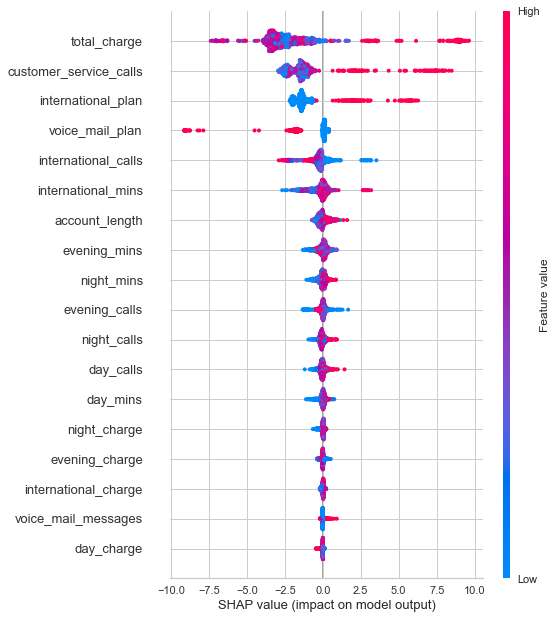

In [70]:
interpret_model(main)

In [71]:
final = finalize_model(main)
un_predictions = predict_model(final, probability_threshold=0.5, data=tele1)
un_predictions.head()

,account_length,voice_mail_plan,voice_mail_messages,day_mins,evening_mins,night_mins,international_mins,customer_service_calls,international_plan,day_calls,day_charge,evening_calls,evening_charge,night_calls,night_charge,international_calls,international_charge,total_charge,prediction_label,prediction_score
0,0.700894,2.074919,1.628835,1.246287,-0.179790,0.879914,-0.184245,-0.575525,-0.458512,0.467149,1.246538,-0.054967,-0.179584,-0.494722,0.879121,-0.582644,-0.185106,1.156116,0,0.9955
1,0.149696,2.074919,1.713645,-0.502083,-0.218882,1.090615,1.324338,-0.575525,-0.458512,1.156916,-0.502324,0.160798,-0.218314,0.148897,1.091505,-0.582644,1.324963,-0.241336,0,0.9904
2,0.937122,-0.511229,-0.491412,0.879720,-1.747595,-0.903445,0.712751,-1.260704,-0.458512,0.679385,0.879873,0.538388,-1.748144,0.202532,-0.902010,0.318849,0.705834,0.019830,0,0.9968
3,-0.453998,-0.511229,-0.491412,1.825698,-2.967685,-0.158388,-1.570510,0.109655,2.656170,-1.602154,1.825848,-0.648322,-2.968136,-0.601992,-0.158666,1.220342,-1.574369,0.406013,0,0.9947
4,-0.690226,-0.511229,-0.491412,-0.415932,-1.190016,-0.375605,-0.143472,0.794835,2.656170,0.626326,-0.415875,1.185684,-1.188982,1.114327,-0.375877,-0.582644,-0.139804,-0.853578,0,0.9990


In [72]:
save_model(final, 'xgb_model1')

Transformation Pipeline and Model Successfully Saved


(Pipeline(memory=Memory(location=C:\Users\aditi\AppData\Local\Temp\joblib),
          steps=[('numerical_imputer',
                  TransformerWrapper(exclude=None,
                                     include=['account_length',
                                              'voice_mail_plan',
                                              'voice_mail_messages', 'day_mins',
                                              'evening_mins', 'night_mins',
                                              'international_mins',
                                              'customer_service_calls',
                                              'international_plan', 'day_calls',
                                              'day_charge', 'evening_calls',
                                              'ev...
                  LGBMClassifier(boosting_type='gbdt', class_weight=None,
                                 colsample_bytree=1.0, importance_type='split',
                                 learning_r